In [3]:
import numpy as np
import pandas as pd

sound_data = pd.read_csv('../datasets/dopamine.csv')
X = sound_data.drop(['filename', 'label'], axis=1)
y = sound_data['label']
sound_data.head()

,filename,chroma_stft,rmse,spectral_centroid,spectral_bandwidth,rolloff,zero_crossing_rate,mfcc1,mfcc2,mfcc3,...,mfcc12,mfcc13,mfcc14,mfcc15,mfcc16,mfcc17,mfcc18,mfcc19,mfcc20,label
0,dopamine_0.wav,0.271349,0.076476,2402.131463,1776.179016,4079.644775,0.195168,-294.241638,89.884674,-29.032949,...,-18.704123,-5.451010,-8.138606,-5.484472,-1.899716,-3.507020,-0.522679,4.371216,-8.291258,dopamine
1,dopamine_1.wav,0.439406,0.044262,2933.097980,2451.848580,5419.588216,0.167150,-348.915619,65.138390,5.660564,...,0.272551,-5.884363,-2.237009,0.817864,-0.500762,-5.192780,2.648233,-5.420618,0.799278,dopamine
2,dopamine_10.wav,0.395109,0.030099,2452.520625,2376.590560,4441.322835,0.128016,-346.111298,88.644691,28.107540,...,0.793999,-6.860541,2.260322,-4.002291,3.440917,-4.592079,6.583166,-7.930673,2.917830,dopamine
3,dopamine_100.wav,0.427627,0.044000,2303.352540,2196.825543,4240.745036,0.122825,-298.546570,96.454788,-1.767370,...,0.139155,-2.436955,0.083012,-5.520330,-2.543206,-9.272289,1.608925,-8.568083,-2.479428,dopamine
4,dopamine_101.wav,0.419465,0.058989,1861.206191,2145.359677,3738.203939,0.087208,-300.529907,114.025688,0.970487,...,-4.269938,-6.959644,-2.581147,-5.520815,-0.134108,-6.931887,-1.059619,-7.001568,-0.123554,dopamine


16


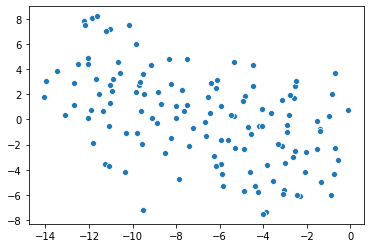

In [21]:
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import seaborn as sns

st_scaler = StandardScaler()
X_ss = st_scaler.fit_transform(X)

pca = PCA(n_components=0.95)
X_pca = pca.fit_transform(X_ss)
print(len(pca.explained_variance_))

s_tsne = TSNE(n_components=2).fit_transform(X_ss)
sns.scatterplot(x=s_tsne[:, 0], y = s_tsne[:, 1])

# K-Means

4


<Figure size 1080x360 with 0 Axes>

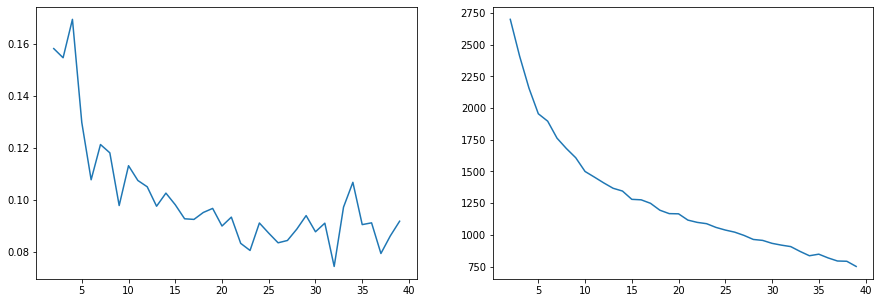

In [36]:
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 5))
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15,5))

inertias = []
sils = []

for k in range(2, 40):
    kmeans = KMeans(n_clusters=k).fit(X_pca)
    inertias.append(kmeans.inertia_)
    sils.append(silhouette_score(X_pca, kmeans.labels_))
    
    
sns.lineplot(x=range(2, 40), y=sils, ax=ax[0])
sns.lineplot(x=range(2, 40), y=inertias, ax=ax[1])

print(np.argmax(sils) + 2)

In [41]:
import librosa
import IPython.display as ipd

kmeans = KMeans(n_clusters=4).fit(X_pca)
y_kmeans = kmeans.labels_

X_clustered = kmeans.fit_transform(X_pca)
X_reper = np.argmin(X_clustered, axis=0)

for sample in sound_data.iloc[X_reper].filename[:]:
    
    print(sample)
    audio = f'../audio/dopamine/{sample}'
    ipd.display(ipd.Audio(audio))

dopamine_118.wav


dopamine_130.wav


dopamine_98.wav


dopamine_49.wav


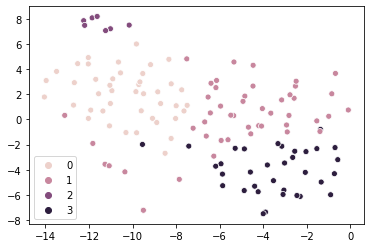

In [49]:
sns.scatterplot(x=s_tsne[:, 0], y=s_tsne[:, 1], hue=y_kmeans)

In [52]:
for sample in sound_data.iloc[y_kmeans == 2].filename[:3]:
    
    print(sample)
    audio = f'../audio/dopamine/{sample}'
    ipd.display(ipd.Audio(audio))

dopamine_45.wav


dopamine_46.wav


dopamine_47.wav


# Agglomerative Clustering

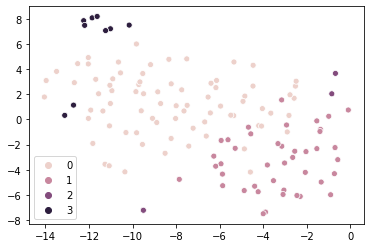

In [103]:
from sklearn.cluster import AffinityPropagation, AgglomerativeClustering

clustering = AgglomerativeClustering(n_clusters=4).fit(X_pca)
sns.scatterplot(x=s_tsne[:, 0], y=s_tsne[:, 1], hue=clustering.labels_)

In [104]:
for sample in sound_data.iloc[clustering.labels_ == 3].filename[:]:
    
    print(sample)
    audio = f'../audio/dopamine/{sample}'
    ipd.display(ipd.Audio(audio))

dopamine_20.wav


dopamine_45.wav


dopamine_46.wav


dopamine_47.wav


dopamine_48.wav


dopamine_49.wav


dopamine_66.wav


dopamine_68.wav


dopamine_69.wav


# Gaussian Mixture

[2 3 3 3 2 1 2 1 3 3 1 3 3 3 3 3 2 1 3 2 3 1 3 3 1 1 3 3 1 2 2 1 1 3 2 3 2
 2 3 3 3 1 3 3 3 2 3 3 3 3 1 3 3 3 1 3 3 3 1 3 1 1 3 3 3 1 1 2 3 1 3 1 0 0
 0 0 0 1 3 1 2 3 3 1 3 3 3 1 1 1 1 1 3 1 1 1 1 0 0 1 1 3 3 3 3 3 3 3 2 1 2
 1 1 2 3 3 1 3 3 3 1 3 1 3 3 1 3 1 1 1 1 1]


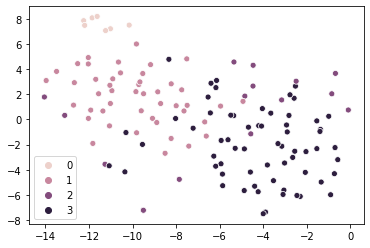

In [507]:
from sklearn.mixture import GaussianMixture

gm = GaussianMixture(n_components=4, n_init=10, random_state=420)
gm.fit(X_pca)
y_gm = gm.predict(X_pca)
print(y_gm)
sns.scatterplot(x=s_tsne[:, 0], y=s_tsne[:, 1], hue=y_gm)

In [227]:

for sample in sound_data.iloc[y_gm == 0].filename[:]:
    
    print(sample)
    audio = f'../audio/dopamine/{sample}'
    ipd.display(ipd.Audio(audio))

dopamine_45.wav


dopamine_46.wav


dopamine_47.wav


dopamine_48.wav


dopamine_49.wav


dopamine_68.wav


dopamine_69.wav


# PCA reconstruction error

In [459]:
clustered_data = {x:X_pca[y_gm == x] for x in range(4)}
    
new_clusters_pca = {x:{} for x in range(4)}
y_pca = y_gm.copy()

#clustered_df = pd.DataFrame(X_pca)
#clustered_df['cluster'] = y_gm
#clustered_df['filename'] = sound_data['filename']

In [463]:
def reconstruction_error(pca, X):
    X_pca = pca.transform(X)
    X_recon = pca.inverse_transform(X_pca)
    mse = np.square(X_recon-X).mean(axis=-1)
    return mse

#cluster_pca = PCA(n_components=0.99).fit(clustered_data[1])

#for c in clustered_data:
#   print(reconstruction_error(cluster_pca, c).mean())

In [675]:
labels = pd.DataFrame(y_gm, columns=['og'])
y_pca = pd.Series(y_gm.copy())

In [676]:
for key, item in clustered_data.items():
    
    cluster_pca = PCA(n_components=0.99).fit(item)
    rec = reconstruction_error(cluster_pca, item)
    threshold = np.std(rec) + rec.mean()
    
    cluster_labels = y_pca.copy()
    
    non_cluster = cluster_labels[cluster_labels != key]
    inds = non_cluster[list(reconstruction_error(cluster_pca, X_pca[cluster_labels != key]) < threshold)].index
    
    cluster_labels.iloc[inds] = key
    #print(f"{key} : {inds}")
    print(f"replaced {len(inds)} instance(s) with {key}")
    
    labels[key] = cluster_labels

replaced 0 instance(s) with 0
replaced 33 instance(s) with 1
replaced 0 instance(s) with 2
replaced 26 instance(s) with 3


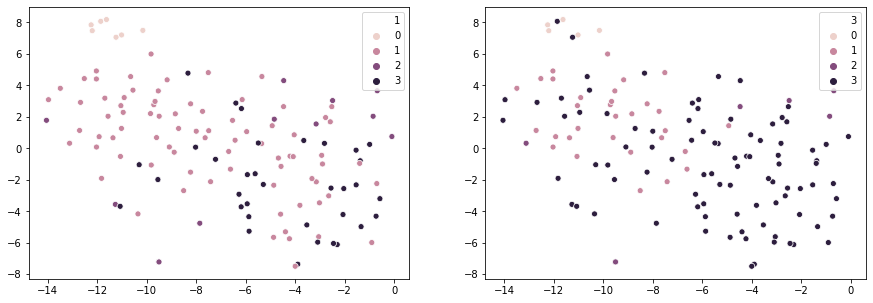

In [685]:
#plt.figure(figsize=(15, 5))
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(15,5))
sns.scatterplot(x=s_tsne[:, 0], y=s_tsne[:, 1], hue=labels[1], ax=ax[0])
sns.scatterplot(x=s_tsne[:, 0], y=s_tsne[:, 1], hue=labels[3], ax=ax[1])

In [691]:
print(len(labels[1][labels[1] == 1]))
print(len(labels[1][labels[1] == 3]), '\n')
print(len(labels[3][labels[1] == 1]))
print(len(labels[3][labels[1] == 3]), '\n')

79
34 

79
34 



In [696]:
for sample in sound_data[labels[3] == 0].filename[:]:
    
    print(sample)
    audio = f'../audio/dopamine/{sample}'
    ipd.display(ipd.Audio(audio))

dopamine_45.wav


dopamine_46.wav


dopamine_47.wav


dopamine_68.wav


dopamine_69.wav


In [711]:
labels.head()

,og,0,1,2,3
0,2,2,2,2,2
1,3,3,3,3,3
2,3,3,3,3,3
3,3,3,1,3,3
4,2,2,2,2,3


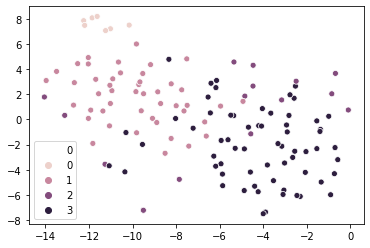

In [722]:
sns.scatterplot(x=s_tsne[:, 0], y=s_tsne[:, 1], hue=labels.drop([1,'og'], axis=1).mode(axis=1)[0])

In [719]:
labels

,og,0,1,2,3
0,2,2,2,2,2
1,3,3,3,3,3
2,3,3,3,3,3
3,3,3,1,3,3
4,2,2,2,2,3
...,...,...,...,...,...
127,1,1,1,1,1
128,1,1,1,1,3
129,1,1,1,1,1
130,1,1,1,1,1


In [733]:
from ..speechsplitter import speechsplitter

ImportError: attempted relative import with no known parent package